# Malaria Detection Using Convolutional Neural Networks (CNN)

## 1. Problem Definition
In a statement,
>  Develop a Convolutional Neural Network (CNN) model to classify blood cell microscopic images as either infected or uninfected with the malaria parasite. The goal is to assist in the early and accurate diagnosis of malaria, which is crucial for effective treatment and containment of the disease.

## 2. Data
> The dataset used for this project is available from the TensorFlow Data Catalog. You can access the dataset through the following link: [Malaria Dataset](https://www.tensorflow.org/datasets/catalog/malaria). The dataset contains 27,558 color images of blood cells with equal instances of parasitized and uninfected cells. The images are in PNG format and the size of each image is 40×40 pixels.

## 3. Project Phases
Our project can be divided into several key phases:
1. **Data Acquisition:** We have obtained a comprehensive dataset from the TensorFlow Data Catalog, comprising 27,558 cell images. These images are evenly divided between parasitized and uninfected cells, providing us with a balanced dataset to train our model.

2. **Data Preprocessing and Analysis:** Before feeding the data into our CNN, we will preprocess the images, perform exploratory data analysis, and extract meaningful insights. This step is crucial for understanding the characteristics of the dataset and preparing it for model training.

3. **Modeling:** We will design and implement a Convolutional Neural Network architecture optimized for image classification. This CNN will learn to differentiate between parasitized and uninfected cells based on the provided cell images.

4. **Error Sanctioning:** During training, we will monitor the model's performance and apply techniques to handle issues like overfitting, underfitting, and vanishing gradients. Ensuring the model's stability is essential for reliable predictions.

5. **Training and Optimization:** We will train our CNN on the preprocessed data, optimizing the model's hyperparameters to achieve the best possible accuracy.

6. **Performance Measurement:** We will evaluate the model's performance using various metrics, such as accuracy, precision, recall, and F1-score, to assess its ability to correctly diagnose malaria-infected cells.

7. **Validation and Testing:** The model's performance will be further validated and tested on a separate dataset to assess its generalization capabilities.

8. **Corrective Measures:** Based on the validation results, we will fine-tune the model and make necessary adjustments to enhance its accuracy and reliability.

## 4. Evaluation
> If we can reach 90% across acuracy, precision, Recall, and F1-Score at correctly classify infected and uninfected blood cells.

## 5. Features
Here, we get to see different information about each of the features in the data.

**Create data dictionary**

- **Image**: The actual image of the blood cell.
- **Label**: A binary label indicating whether the cell is parasitized (1) or uninfected (0).

By the end of this project, we aim to create a powerful tool that can contribute to the early and accurate diagnosis of malaria, potentially saving lives and reducing the burden of this devastating disease. Let's embark on this journey to harness the capabilities of machine learning and make a positive impact on healthcare.


In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow.keras.layers import Dense, Dropout, Flatten, Conv2D, MaxPooling2D, BatchNormalization, Activation

## Data

In [2]:
# Load the data
df, df_info = tfds.load('malaria', 
                        with_info=True,
                        as_supervised=True, 
                        shuffle_files = True, 
                        split=['train'])

Metal device set to: Apple M2

systemMemory: 8.00 GB
maxCacheSize: 2.67 GB



In [3]:
for data in df[0].take(1):
   print(data)

(<tf.Tensor: shape=(103, 103, 3), dtype=uint8, numpy=
array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8)>, <tf.Tensor: shape=(), dtype=int64, numpy=0>)


In [4]:
df_info

tfds.core.DatasetInfo(
    name='malaria',
    full_name='malaria/1.0.0',
    description="""
    The Malaria dataset contains a total of 27,558 cell images with equal instances
    of parasitized and uninfected cells from the thin blood smear slide images of
    segmented cells.
    """,
    homepage='https://lhncbc.nlm.nih.gov/publication/pub9932',
    data_path='/Users/oabas/tensorflow_datasets/malaria/1.0.0',
    file_format=tfrecord,
    download_size=337.08 MiB,
    dataset_size=317.62 MiB,
    features=FeaturesDict({
        'image': Image(shape=(None, None, 3), dtype=uint8),
        'label': ClassLabel(shape=(), dtype=int64, num_classes=2),
    }),
    supervised_keys=('image', 'label'),
    disable_shuffling=False,
    splits={
        'train': <SplitInfo num_examples=27558, num_shards=4>,
    },
    citation="""@article{rajaraman2018pre,
      title={Pre-trained convolutional neural networks as feature extractors toward
      improved malaria parasite detection in thin blood 

In [5]:
TRAIN_RATIO = 0.8
VAL_RATIO = 0.1
TEST_RATIO = 0.1

def splits(dataset, TRAIN_RATIO, VAL_RATIO, TEST_RATIO):
  DATASET_SIZE = len(dataset)

  train_dataset = dataset.take(int(TRAIN_RATIO*DATASET_SIZE))
  # Skip the already taken elements
  val_test_dataset = dataset.skip(int(TRAIN_RATIO*DATASET_SIZE))
  val_dataset = val_test_dataset.take(int(VAL_RATIO*DATASET_SIZE)) # take the first VAL_RATIO*DATASET_SIZE elements

  test_dataset = val_test_dataset.skip(int(VAL_RATIO*DATASET_SIZE))
  return train_dataset, val_dataset, test_dataset

In [6]:
train_dataset, val_dataset, test_dataset = splits(df[0], TRAIN_RATIO, VAL_RATIO, TEST_RATIO )
train_dataset

<_TakeDataset element_spec=(TensorSpec(shape=(None, None, 3), dtype=tf.uint8, name=None), TensorSpec(shape=(), dtype=tf.int64, name=None))>

In [7]:
print(list(train_dataset.as_numpy_iterator()))

[(array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       ...,

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]]], dtype=uint8), 0), (array([[[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
        ...,
        [0, 0, 0],
        [0, 0, 0],
        [0, 0, 0]],

       [[0, 0, 0],
        [0, 0, 0],
        [0, 0, 0],
      

### Data Visualization

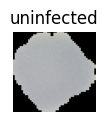

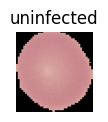

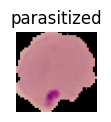

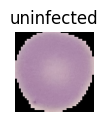

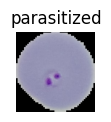

...

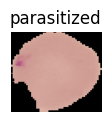

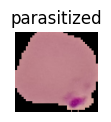

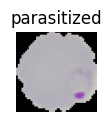

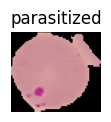

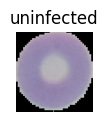

In [8]:
for i, (image, label) in enumerate(train_dataset.take(16)):
  ax = plt.subplot(4, 4, i + 1)
  plt.imshow(image)
  plt.title(df_info.features['label'].int2str(label))
  plt.axis("off")
  plt.show()

In [9]:
df_info.features['label'].int2str(1)

'uninfected'

### Data Preprocessing

In [14]:
# Resizing
IMG_SIZE = 224
def resize_rescale(image, label):
    resize_res = tf.image.resize(image, (IMG_SIZE, IMG_SIZE))/255.0
    return resize_res, label

In [15]:
train_dataset = train_dataset.map(resize_rescale)

In [16]:
for image, label in train_dataset.take(1):
  print(image.shape, label)

(224, 224, 3) tf.Tensor(1, shape=(), dtype=int64)


In [ ]:
# Shuffle and batch
BATCH_SIZE = 32

train_dataset = train_dataset.shuffle(buffer_size=8, reshuffle_each_iteration=True).batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)